In [129]:
#Figure for the manifold plot

#The idea is to save the final 4100 state trajectory from the algorithm, 
#and at each point simulate forward in time without control to ensure that 
#at every timestep (if control were to be lost), we would escape to the right. 
#Do this for both the Earth Moon system and the Saturn Enceladus system

In [130]:
using LinearAlgebra
using DifferentialEquations
using Plots
using DelimitedFiles
using ForwardDiff

In [131]:
#parameters for Earth Moon System
μ = 1.215e-2
μ1 = 1-μ
μ2 = μ

#position of mass 1
pose_m1 = [-μ, 0, 0]

#position of mass 2
pose_m2 = [1-μ, 0, 0]

#value obtained from 3BP textbook (original)
L = 3.850e5 #in km - distance between centers of m1 and m2
#V_ = 1.025 #in km/s - orbital velocity of m1
#T_ = 2.361e6 #in seconds - orbital period of m1 and m2


#working
#########################################################################################
#updated for time unit to be in days
T_ = 2.361e6/86400 #in days - orbital period of m1 and m2
time_scale = T_/(2*pi)

#time unit of days
V_ = L/time_scale
acceleration_scale = L/((time_scale)^2)
##########################################################################################

#state of the L1 and L2 Lagrange points (computed offline)
XL1 = [0.8369180073169304, 0, 0, 0, 0, 0]
XL2 = [1.1556799130947355, 0, 0, 0, 0, 0]

6-element Vector{Float64}:
 1.1556799130947355
 0.0
 0.0
 0.0
 0.0
 0.0

In [132]:
function effective_potential(X)
    x = X[1]
    y = X[2]
    z = X[3]

    r1 = sqrt((x+μ2)^2 + y^2 + z^2) 
    r2 = sqrt((x-μ1)^2 + y^2 + z^2)
    #assuming m3 is unit mass
   
    U = (-μ1/r1)-(μ2/r2)-0.5*(x^2+y^2)
   
    return U
    
end

effective_potential (generic function with 1 method)

In [133]:
function three_body_prob_dynamics(x)
    
    q = zeros(eltype(x),3)
    v = zeros(eltype(x),3)
    q = x[1:3]
    v = x[4:6]

    ẋ = zeros(eltype(x),6)
    U_q = zeros(eltype(x),3)
    
    U_q = (ForwardDiff.gradient(_x -> effective_potential(_x), q))
        
    ẋ[1:3] = v
    ẋ[4] = 2*v[2] - U_q[1] 
    ẋ[5] = -2*v[1] - U_q[2]
    ẋ[6] = -U_q[3]

    return ẋ
end

three_body_prob_dynamics (generic function with 1 method)

In [134]:
XL2*L 

6-element Vector{Float64}:
 444936.76654147316
      0.0
      0.0
      0.0
      0.0
      0.0

In [135]:
pose_m2*L 

3-element Vector{Float64}:
 380322.25
      0.0
      0.0

In [136]:
#inputs are in the custom SI unit scale

function three_body_prob_dynamics_scaled(x)

    q_original = zeros(eltype(x),3)
    v_original = zeros(eltype(x),3)
    
    q_original = x[1:3]/L 
    v_original = x[4:6]/V_
    
    x_original = [q_original; v_original]

    #original is in the CR3BP units
    ẋ_original = zeros(eltype(x),6)

    #calculate the original xdot (no scaling)

    ẋ_original = three_body_prob_dynamics(x_original)

    #then scale the output
    v_scaled = ẋ_original[1:3]*V_
    
    a_scaled = ẋ_original[4:6]*acceleration_scale

    ẋ_scaled = [v_scaled; a_scaled]

    return ẋ_scaled

end

three_body_prob_dynamics_scaled (generic function with 1 method)

In [137]:
#solve using DifferentialEquations.jl
function justdynamics_DFJL!(du, u, p, t)
    
    du[1:6] = three_body_prob_dynamics_scaled(u[1:6])
    
end

justdynamics_DFJL! (generic function with 1 method)

In [138]:
#gets the state and for the entire solution

function get_state(solution)
    
    N = size(solution.u)[1]

    all_states = zeros(6, N)

    for i=1:N
        all_states[:,i] = solution.u[i][1:6]
    end
    
    #all states and all stm are functions of t
    #solution.t is the time
    return all_states
end

get_state (generic function with 1 method)

In [139]:
#integrate just the dynamics
function just_dynamics_integrate(x_0, period)

    condition(u,t,integrator) = u[1] - 4.75e5
    
    affect!(integrator) = terminate!(integrator)
     
    cb = ContinuousCallback(condition, affect!)
    
    tspan = (0.0, period)
    prob = ODEProblem(justdynamics_DFJL!, x_0, tspan)
    sol = solve(prob, TsitPap8(), abstol=1e-12, reltol=1e-12, callback=cb)
    
    return sol
    
end

just_dynamics_integrate (generic function with 1 method)

In [140]:
#whole x trajectory
#xtraj  = readdlm("xtraj_earthmoon.txt", ',')

#xtraj  = readdlm("xtraj_moon_ctg.txt", ',')
#xtraj  = readdlm("xtraj_moon_tube.txt", ',')



#xtraj  = readdlm("xtraj_moon_ctg_larger_dev.txt", ',')
xtraj  = readdlm("xtraj_moon_tube_larger_dev.txt", ',')

#xtraj  = readdlm("xtraj_moon_tube_larger_dev_tunev1.txt", ',')

6×4100 Matrix{Float64}:
     4.3125e5      4.31272e5      4.31347e5  …      4.31268e5      4.31251e5
     0.0        5801.16       11360.8           -5775.29          -0.198114
  2286.77       2237.81        2094.68           2221.05        2269.82
     0.0         120.453        306.583          -101.351          0.0310211
 15809.4       15343.2        14521.3           15364.4        15648.7
     0.0        -261.98        -504.301      …    260.536          0.464072

In [141]:
x_reference  = readdlm("moon_reference.txt", ',')

6×41 Matrix{Float64}:
     4.3125e5  431267.0        4.31338e5  …  431267.0        4.3125e5
     0.0         5775.21   11343.6            -5775.22      -0.00385146
  2286.77        2237.81    2094.63            2237.81    2286.77
     0.0          101.372    306.583           -101.372      0.00219923
 15649.0        15364.7    14545.9            15364.7    15649.0
     0.0         -262.025   -504.475      …     262.025      0.000129386

In [142]:
escape_traj = Matrix{Float64}[]
dims_escape = zeros(2, 4100)

2×4100 Matrix{Float64}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0

In [143]:
days_time = 14.852171558441775*2.5

37.13042889610443

In [144]:
#at each of these points in x traj, simulate forward by a bit and hopefully all escape to the right ..

for i=1:4100

    integrate_sol = just_dynamics_integrate(xtraj[:,i], days_time)

    x_escape = get_state(integrate_sol)

    dims_escape[1,i] = size(x_escape)[1]

    dims_escape[2,i] = size(x_escape)[2]

    push!(escape_traj, x_escape)

end

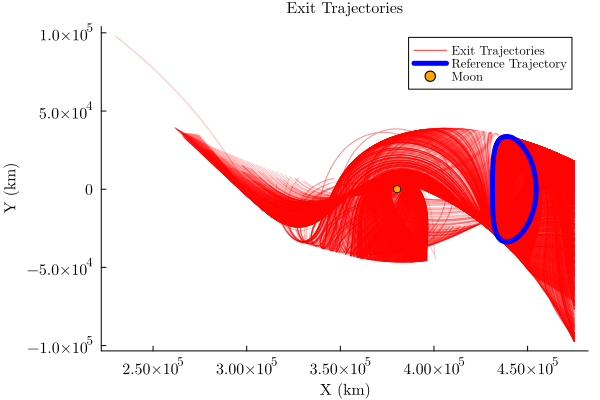

In [145]:
plot(x_reference[1,:], x_reference[2,:], label=nothing)

for i=2:4100
    plot!(escape_traj[i][1,:], escape_traj[i][2,:], label=nothing, color=:red, fontfamily="Computer Modern", alpha=0.25) 
end

plot!(escape_traj[1][1,:], escape_traj[1][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 

plot!(x_reference[1,:], x_reference[2,:], label="Reference Trajectory",
 linewidth=5, color=:blue, fontfamily="Computer Modern", xguidefontsize=10, xtickfontsize=10, 
 yguidefontsize=10, ytickfontsize=10)

 title!("Exit Trajectories", fontfamily="Computer Modern", titlefontsize=10) 
 xlabel!("X (km)")
 ylabel!("Y (km)")

 exit_trajectories = scatter!([pose_m2[1]*L], [0], label = "Moon", color=:orange, fontfamily="Computer Modern", grid=false) 


#savefig("exit_trajectories_moon_tube_larger_dev.pdf")

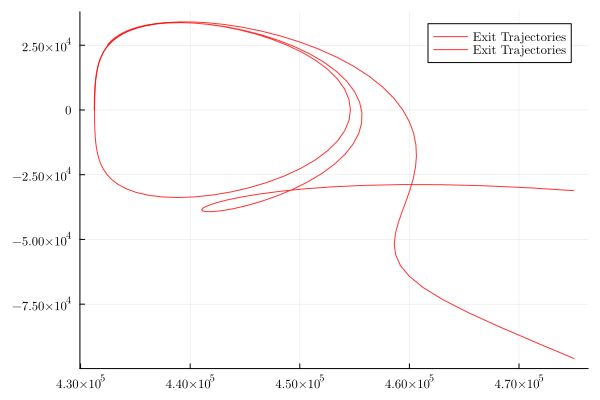

In [146]:
plot(escape_traj[1][1,:], escape_traj[1][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[2][1,:], escape_traj[2][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[3][1,:], escape_traj[3][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[4][1,:], escape_traj[4][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[5][1,:], escape_traj[5][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 

#this goes to the left
plot!(escape_traj[6][1,:], escape_traj[6][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8)
#plot!(escape_traj[7][1,:], escape_traj[7][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[8][1,:], escape_traj[8][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[9][1,:], escape_traj[9][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 
#plot!(escape_traj[10][1,:], escape_traj[10][2,:], label="Exit Trajectories", color=:red, fontfamily="Computer Modern", alpha=0.8) 

In [147]:
escape_traj[6] 

6×135 Matrix{Float64}:
     4.32457e5      4.32494e5      4.32541e5  …  475000.0   475000.0
 25162.9        25347.7        25575.5           -31158.4   -31158.4
  1220.65        1201.68        1177.9             3167.37    3167.37
  1929.35        1967.61        2015.59           19482.3    19482.3
  9828.57        9730.09        9606.73           -6034.58   -6034.58
 -1001.13       -1006.25       -1012.49       …     231.79     231.79

In [148]:
delta6 = escape_traj[6][:,1] - x_reference[:,6] 

6-element Vector{Float64}:
  6.436625299102161
  0.7134210008807713
  0.37557035874397116
 -1.9983335341694328
 -3.8957921302499017
  0.34735007196161405

In [149]:
unstable6 = [
    0.7801762327955793,
    -0.44884175733022125,
     0.033330574887577055,
     0.42582501241831283,
    -0.0844323376866143,
     0.0173041783103938
]

6-element Vector{Float64}:
  0.7801762327955793
 -0.44884175733022125
  0.033330574887577055
  0.42582501241831283
 -0.0844323376866143
  0.0173041783103938

In [150]:
dot(delta6, unstable6) 

4.198007960262139

In [152]:
#savefig(exit_trajectories, "exit_trajectories_earthmoon_tube_largerdev")

In [153]:
any(x -> x < 4e5, escape_traj[2][1,:]) 

false

In [154]:
#left or right for trajectories 2:4100
left = zeros(4099)

for i=2:4100

    left[i-1] = any(x -> x < 4e5, escape_traj[i][1,:]) 

end

In [155]:
#there are 99 trajectories that do go to the left

In [156]:
1 - sum(left)/4099 

0.7621371066113687